In [2]:
import os
import json
import numpy as np
import cv2
import matplotlib.pyplot as plt
import glob
from PIL import Image, ImageDraw
%matplotlib inline

from sklearn.preprocessing import MinMaxScaler
from sklearn.externals import joblib

from tensorflow.python.keras.layers import Input, BatchNormalization
from tensorflow.python.keras.models import Model, load_model
from tensorflow.python.keras.layers import Convolution2D
from tensorflow.python.keras.layers import Dropout, Flatten, Dense

import donkeybarn as barn

#location where to save datasets
data_dir = os.path.expanduser('~/donkey_data')

print(barn.__file__)

/home/wroscoe/code/donkey/donkeybarn/donkeybarn/__init__.py


In [5]:
#download and load dataset
#track_data = barn.datasets.DriveaiLabeled.load(data_dir = data_dir)
track_data = barn.datasets.MakerFaireLabeled.load(data_dir = data_dir)
#load camera model to undistort and do birdseye perspective
fe = barn.cv.camera.FishEyeCamera(**barn.configs.donkey2_camera_params)

#load image labels
label_json_path = os.path.join(track_data.base_dir, 'labels.json')
data= barn.datasets.LabelBoxData(label_json_path)
data.gen_external_key_index()


File already exists.


In [6]:
ix = 205
Image.open(track_data.img_paths[ix])
img_name = os.path.basename(track_data.img_paths[ix])
print(img_name)
#data.key_index
mask = np.array(data.get_mask_from_key(img_name, 'Center Line'))


505_cam-image_array_.jpg


## Generate augmented source images with target line coeficients. 

In [7]:
import random
X = []
Y = []

for _ in range(10000):
    try:
        ix = np.random.randint(0,len(track_data.img_paths))

        img_name = os.path.basename(track_data.img_paths[ix])
        img = np.array(Image.open(track_data.img_paths[ix]))
        img_aug = barn.cv.augment.augment_images(img)
        
        mask = np.array(data.get_mask_from_key(img_name, 'Center Line'))
        mask_undistorted = fe.undistort(mask)
        mask_birdseye = fe.birdseye(mask_undistorted)
        
        #output the coefficients of the line [c2, c1, c0] such that 
        # c2*x**2 + c1*x + c0 = y
        coef = barn.cv.lanes.find_line_coef_from_mask(mask_birdseye)
        X.append(img_aug)
        Y.append(coef)
        
        #img_with_line = barn.cv.draw.line_from_coef(img_birdseye, coef )
        
        """
        fig = barn.show.imgs([
            {'name': 'img_undistorted', 'array':  np.array(img_undistorted)}, 
            #{'name': 'mask_undistored', 'array':  mask_undistorted}, 
            {'name': 'img_birdseye', 'array':  img_birdseye}, 
            #{'name': 'mask_birdseye', 'array':  mask_birdseye},
            {'name': 'img_with_predicted_line', 'array':  img_with_predicted_line}, 
            {'name': 'birdseye', 'array':  img_with_line}
        ])
        """
    except KeyError:
        print(ix)
    except IndexError:
        print('index error', ix)

NameError: name 'add_rectangles' is not defined

In [37]:
#load the model
model = default_linear()

#put the data in the format keras expects
X = np.array(X)
Y = np.stack(Y, axis=0)
print(Y.shape, X.shape)

(10000, 3) (10000, 120, 160, 3)


In [38]:
#Scale the line coeficients to between 0 and 1
scaler = MinMaxScaler()
Y_scaler = scaler.fit_transform(Y)
Y_scaled = scaler.transform(Y)
Y_scaled[0]

array([0.6351638 , 0.38828106, 0.59145529])

In [39]:
#train the model
model.fit(X, Y_scaled, epochs=30, validation_split=.2, batch_size=128)

Train on 8000 samples, validate on 2000 samples
Epoch 1/30
8000/8000 [==============================] - 4s 472us/step - loss: 0.0225 - val_loss: 0.0531
Epoch 2/30
8000/8000 [==============================] - 3s 359us/step - loss: 0.0096 - val_loss: 0.0239
Epoch 3/30
8000/8000 [==============================] - 3s 359us/step - loss: 0.0072 - val_loss: 0.0165
Epoch 4/30
8000/8000 [==============================] - 3s 357us/step - loss: 0.0056 - val_loss: 0.0124
Epoch 5/30
8000/8000 [==============================] - 3s 358us/step - loss: 0.0047 - val_loss: 0.0104
Epoch 6/30
8000/8000 [==============================] - 3s 357us/step - loss: 0.0043 - val_loss: 0.0066
Epoch 7/30
8000/8000 [==============================] - 3s 356us/step - loss: 0.0035 - val_loss: 0.0041
Epoch 8/30
8000/8000 [==============================] - 3s 359us/step - loss: 0.0034 - val_loss: 0.0025
Epoch 9/30
8000/8000 [==============================] - 3s 358us/step - loss: 0.0027 - val_loss: 0.0012
Epoch 10/30
8000

In [40]:
#train the model on the whole dataset.
model.fit(X, Y_scaled, epochs=1, validation_split=0., batch_size=128)

Epoch 1/1
10000/10000 [==============================] - 3s 313us/step - loss: 0.0011


In [46]:
model.count_params()


135863

In [41]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
img_in (InputLayer)          (None, 120, 160, 3)       0         
_________________________________________________________________
batch_normalization_12 (Batc (None, 120, 160, 3)       12        
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 58, 78, 16)        1216      
_________________________________________________________________
conv2d_16 (Conv2D)           (None, 27, 37, 24)        9624      
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 12, 17, 32)        19232     
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 5, 8, 64)          18496     
_________________________________________________________________
flattened (Flatten)          (None, 2560)              0         
__________

In [42]:
model.save(filepath='/home/wroscoe/donkey_data/line_finder.h5')
joblib.dump(scaler, '/home/wroscoe/donkey_data/model-scaler.pkl')

['/home/wroscoe/donkey_data/model-scaler.pkl']

In [43]:

Yp_scaled = model.predict(X)
Yp = scaler.inverse_transform(Yp_scaled)

/home/wroscoe/miniconda3/envs/dk/lib/python3.6/site-packages/matplotlib/font_manager.py:1331: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


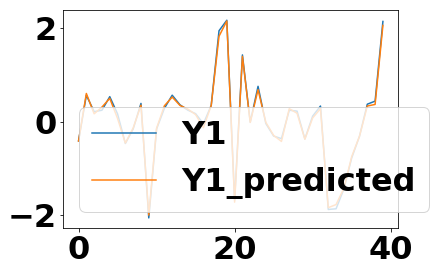

In [44]:
y1, = plt.plot(Y[40:80, 1], label='Y1')
#y2, = plt.plot(Y2_scaled[40:80], label="Y1_scaled" )
y3, = plt.plot(Yp[40:80, 1], label="Y1_predicted")
plt.legend(handles=[y1, y3 ])

0 

/home/wroscoe/miniconda3/envs/dk/lib/python3.6/site-packages/matplotlib/font_manager.py:1331: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


'Figure' object has no attribute 'close'
1 'Figure' object has no attribute 'close'
2 'Figure' object has no attribute 'close'
3 'Figure' object has no attribute 'close'
4 'Figure' object has no attribute 'close'
5 'Figure' object has no attribute 'close'
6 'Figure' object has no attribute 'close'
7 'Figure' object has no attribute 'close'
8 'Figure' object has no attribute 'close'
9 'Figure' object has no attribute 'close'
10 'Figure' object has no attribute 'close'
11 'Figure' object has no attribute 'close'
12 'Figure' object has no attribute 'close'
13 'Figure' object has no attribute 'close'
14 'Figure' object has no attribute 'close'
15 'Figure' object has no attribute 'close'
16 'Figure' object has no attribute 'close'
17 'Figure' object has no attribute 'close'
18 'Figure' object has no attribute 'close'
19 'Figure' object has no attribute 'close'
20 

/home/wroscoe/miniconda3/envs/dk/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


'Figure' object has no attribute 'close'
21 'Figure' object has no attribute 'close'
22 'Figure' object has no attribute 'close'
23 'Figure' object has no attribute 'close'
24 'Figure' object has no attribute 'close'
25 'Figure' object has no attribute 'close'
26 'Figure' object has no attribute 'close'
27 'Figure' object has no attribute 'close'
28 'Figure' object has no attribute 'close'
29 'Figure' object has no attribute 'close'
30 'Figure' object has no attribute 'close'
31 'Figure' object has no attribute 'close'
32 'Figure' object has no attribute 'close'
33 'Figure' object has no attribute 'close'
34 'Figure' object has no attribute 'close'
35 'Figure' object has no attribute 'close'
36 'Figure' object has no attribute 'close'
37 'Figure' object has no attribute 'close'
38 'Figure' object has no attribute 'close'
39 'Figure' object has no attribute 'close'
40 'Figure' object has no attribute 'close'
41 'Figure' object has no attribute 'close'
42 'Figure' object has no attribute

204 'Figure' object has no attribute 'close'
205 'Figure' object has no attribute 'close'
206 'Figure' object has no attribute 'close'
207 'Figure' object has no attribute 'close'
208 'Figure' object has no attribute 'close'
209 'Figure' object has no attribute 'close'
210 'Figure' object has no attribute 'close'
211 'Figure' object has no attribute 'close'
212 'Figure' object has no attribute 'close'
213 'Figure' object has no attribute 'close'
214 'Figure' object has no attribute 'close'
215 'Figure' object has no attribute 'close'
216 'Figure' object has no attribute 'close'
217 'Figure' object has no attribute 'close'
218 'Figure' object has no attribute 'close'
219 'Figure' object has no attribute 'close'
220 'Figure' object has no attribute 'close'
221 'Figure' object has no attribute 'close'
222 'Figure' object has no attribute 'close'
223 'Figure' object has no attribute 'close'
224 'Figure' object has no attribute 'close'
225 'Figure' object has no attribute 'close'
226 'Figur

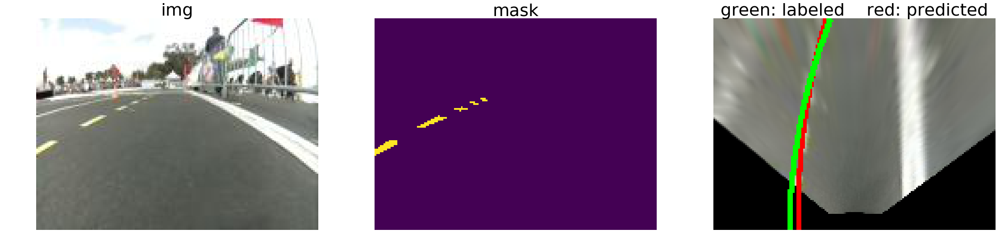

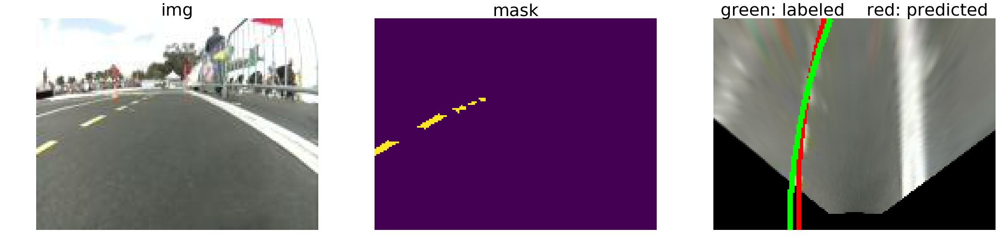

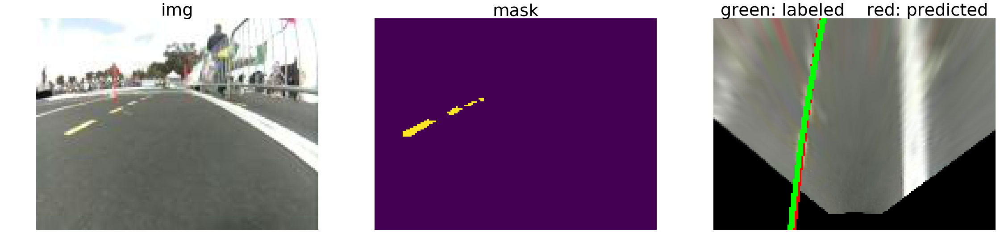

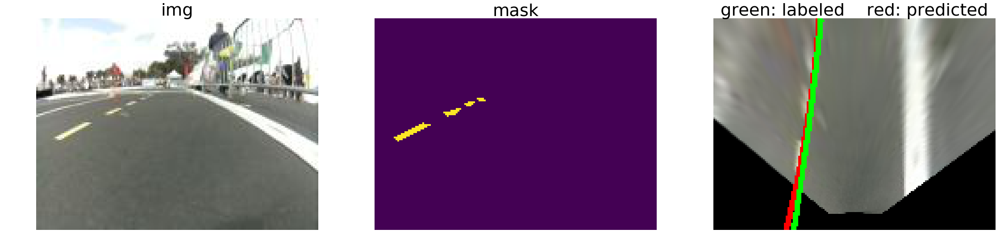

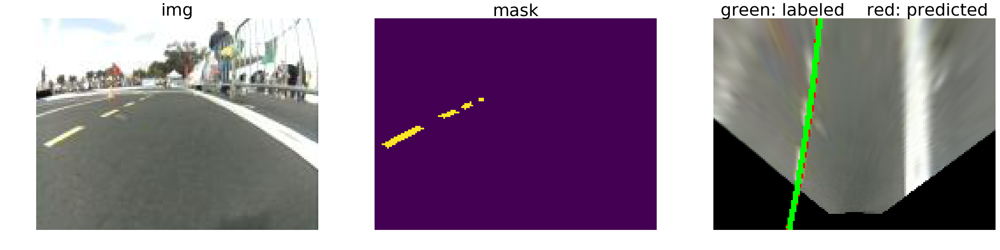

...

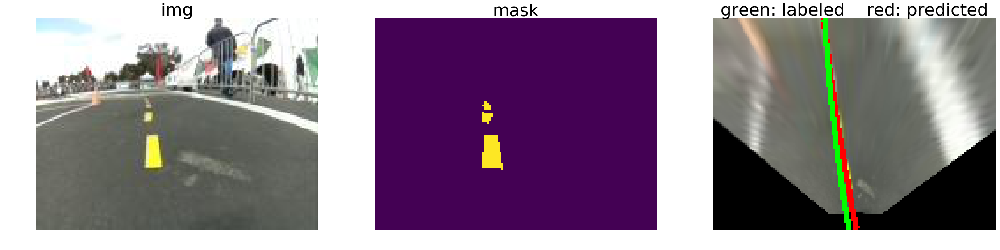

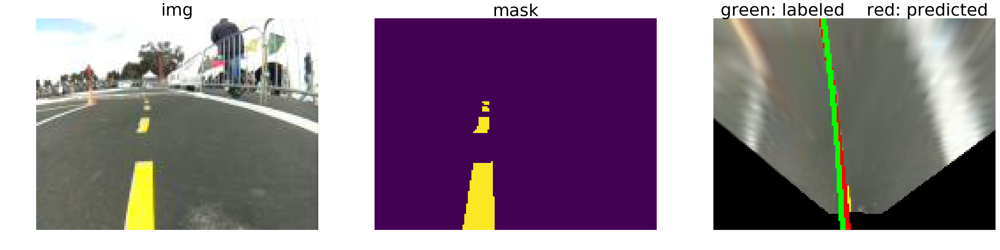

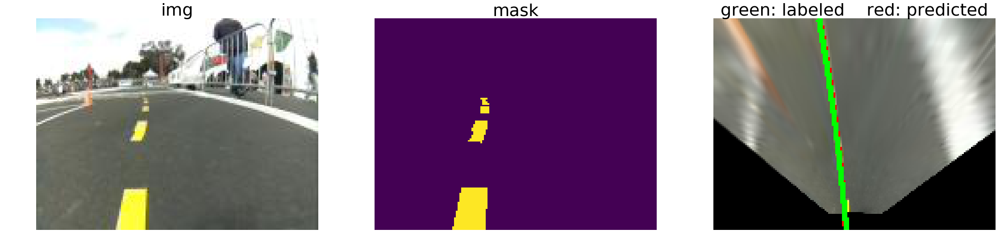

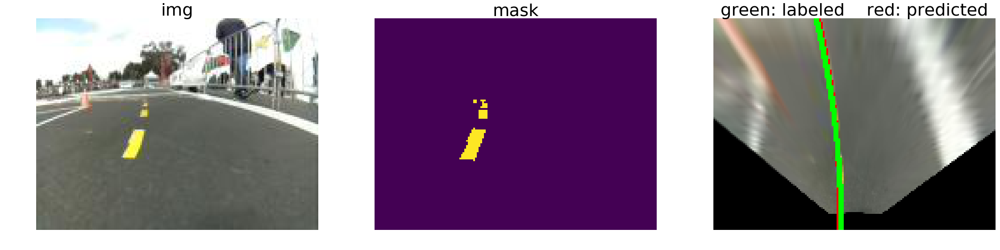

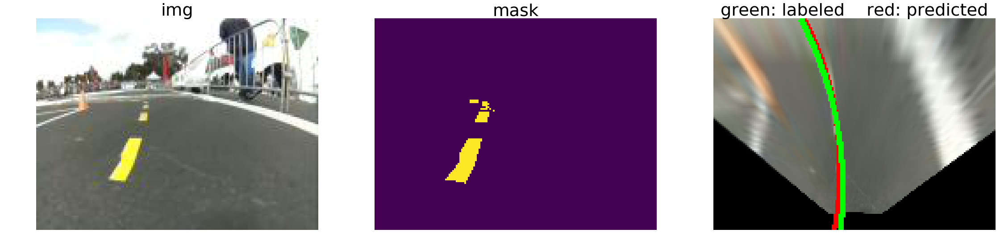

In [17]:
animation_folder = os.path.expanduser('~/donkey_predict_lines_animation')
if not os.path.exists(animation_folder):
    os.makedirs(animation_folder)
    
import matplotlib
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 32}

matplotlib.rc('font', **font)


for ix in range(0,len(track_data.img_paths)):

    try:
        img_name = os.path.basename(track_data.img_paths[ix])
        img = np.array(Image.open(track_data.img_paths[ix]))
        img_undistorted = fe.undistort(img)
        img_birdseye = fe.birdseye(img_undistorted)
        mask = np.array(data.get_mask_from_key(img_name, 'Center Line'))
        mask_undistorted = fe.undistort(mask)
        mask_birdseye = fe.birdseye(mask_undistorted)
        coef = barn.cv.lanes.find_line_coef_from_mask(mask_birdseye)

        Yp_scaled = model.predict(np.array([img]))
        Yp = scaler.inverse_transform(Yp_scaled)

        #draw calculated and actual lines on birdseye image
        img_with_lines = barn.cv.draw.line_from_coef(img_birdseye, coef )
        img_with_lines = barn.cv.draw.line_from_coef(img_with_lines, Yp[0] , color = (0,255,0))


        print(ix, end=" ")

        fig = barn.show.imgs([
            {'name': 'img', 'array':  np.array(img)}, 
            {'name': 'mask', 'array':  mask}, 
            #{'name': 'img_birdseye', 'array':  img_birdseye}, 
            #{'name': 'mask_birdseye', 'array':  mask_birdseye},
            {'name': 'green: labeled    red: predicted', 'array':  img_with_lines}, 
        ])

        file_name = '{0:06}.png'.format(ix)
        file_path = os.path.join(animation_folder, file_name)
        fig.set_size_inches(38.5, 10.5)
        fig.savefig(file_path)
        fig.close()
    except Exception as e:
        print(e)

    



In [ ]:
from moviepy.editor import *
import glob

In [13]:

image_paths = glob.glob(os.path.join(animation_folder, '*.png'))
image_paths = sorted(image_paths)
clip = ImageSequenceClip(image_paths, fps=20)


clip.write_videofile(os.path.join(animation_folder, 'line_following.mp4'),fps=20)
ipython_display(clip) # embed

[MoviePy] >>>> Building video /home/wroscoe/donkey_predict_lines_animation/line_following.mp4
[MoviePy] Writing video /home/wroscoe/donkey_predict_lines_animation/line_following.mp4


100%|██████████| 221/221 [00:12<00:00, 18.16it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: /home/wroscoe/donkey_predict_lines_animation/line_following.mp4 



100%|██████████| 221/221 [00:11<00:00, 18.57it/s]


# script to time inference

In [30]:
import tensorflow as tf

25 'Figure' object has no attribute 'close'
26 'Figure' object has no attribute 'close'


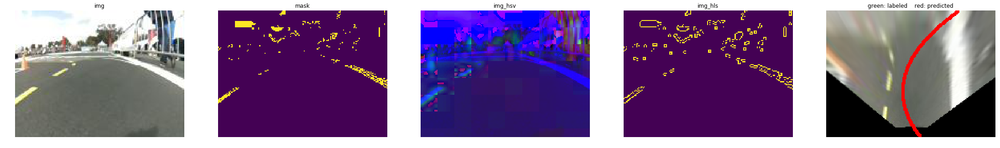

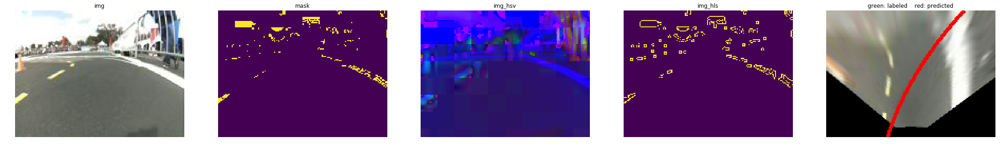

In [76]:
animation_folder = os.path.join(data_dir, 'line_animation')

for ix in range(25,27):

    try:
        img_name = os.path.basename(track_data.img_paths[ix])
        img = np.array(Image.open(track_data.img_paths[ix]))
        img_undistorted = fe.undistort(img)
        img_birdseye = fe.birdseye(img_undistorted)
        img_hsv = convert_hsv(img)
        img_hls = convert_hls(img)

        #lower = np.uint8([ 30,   10, 175])
        #upper = np.uint8([ 255, 255, 255])
        lower = np.uint8([ 30,   0, 200])
        upper = np.uint8([ 36, 255, 255])
        
        yellow_hls_mask = cv2.inRange(img_hls, lower, upper) 
        img_mask = barn.cv.filter.HSV_thresh(img_birdseye,v_thresh= [200, 255])
        
        img_grayscale = grayscale(img)
        img_canny = barn.cv.filter.canny(yellow_hls_mask)
        img_gaussian = gaussian_blur(img, 5)
        
        coef = barn.cv.lanes.find_line_coef_from_mask(img_mask)
        
        img_with_lines = barn.cv.draw.line_from_coef(img_birdseye, coef )
        #img_with_lines = barn.cv.draw.line_from_coef(img_with_lines, Yp[0] , color = (0,255,0))

        print(ix, end=" ")

        fig = barn.show.imgs([
            {'name': 'img', 'array':  np.array(img)}, 
            {'name': 'mask', 'array':  yellow_hls_mask}, 
            {'name': 'img_hsv', 'array':  img_hsv}, 
            {'name': 'img_hls', 'array':  img_canny},
            {'name': 'green: labeled    red: predicted', 'array':  img_with_lines}, 
        ])

        file_name = '{0:06}.png'.format(ix)
        file_path = os.path.join(animation_folder, file_name)
        fig.set_size_inches(38.5, 10.5)
        fig.savefig(file_path)
        fig.close()
        
        

        
    except Exception as e:
        print(e)